# Amazon Fine Food Reviews Analysis
Data Source: https://www.kaggle.com/snap/amazon-fine-food-reviews
The Amazon Fine Food Reviews dataset consists of reviews of fine foods from Amazon.<br>

Number of reviews: 568,454<br>
Number of users: 256,059<br>
Number of products: 74,258<br>
Timespan: Oct 1999 - Oct 2012<br>
Number of Attributes/Columns in data: 10 

Attribute Information:

1. Id
2. ProductId - unique identifier for the product
3. UserId - unqiue identifier for the user
4. ProfileName
5. HelpfulnessNumerator - number of users who found the review helpful
6. HelpfulnessDenominator - number of users who indicated whether they found the review helpful or not
7. Score - rating between 1 and 5
8. Time - timestamp for the review
9. Summary - brief summary of the review
10. Text - text of the review


#### Objective:
Given a review, determine whether the review is positive (Rating of 4 or 5) or negative (rating of 1 or 2).

<img src="http://nycdatascience.com/blog/wp-content/uploads/2016/04/NewCover.png">

# Kmeans


* k-means clustering is a method of vector quantization, originally from signal processing, that is popular for cluster analysis in data mining.
<img src="https://www.mathworks.com/matlabcentral/mlc-downloads/downloads/submissions/19344/versions/1/screenshot.jpg">

# Hierarchical Clustering / Dendrogram
* Hierarchical clustering is where you build a cluster tree (a dendrogram) to represent data, where each group (or “node”) links to two or more successor groups. The groups are nested and organized as a tree, which ideally ends up as a meaningful classification scheme.

<img src="http://www.statisticshowto.com/wp-content/uploads/2016/11/clustergram.png">

# DBSCAN Clustering
<img src="https://cdn-images-1.medium.com/max/2000/1*zbm_3K647rvNDmgL6HWUNQ.png">

# Elbow Method
* The Elbow method is a method of interpretation and validation of consistency within cluster analysis designed to help finding the appropriate number of clusters in a dataset.
<img src="https://image.slidesharecdn.com/kmeans-demo-150305202643-conversion-gate01/95/kmeans-with-canopy-clustering-24-638.jpg?cb=1425608917">

In [12]:
!pip install pydrive
!pip install gensim
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
 
# 1. Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
downloaded = drive.CreateFile({'id':'1cZS7OUXVft4KTZ1AzZPu95hSgWzu3aC8'}) # replace the id with id of file you want to access
downloaded.GetContentFile('final.sqlite')

In [0]:
# loading libraries and data

%matplotlib inline

import sqlite3                          # for sql database
import pandas as pd
import numpy as np
import nltk                             # nltk:- Natural Language Processing Toolkit
import string
import re
import io
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer
from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix


import pickle
def saveindisk(obj,filename):
    pickle.dump(obj,open(filename+".p","wb"), protocol=4)
def openfromdisk(filename):
    temp = pickle.load(open(filename+".p","rb"))
    return temp


con = sqlite3.connect("final.sqlite")

# Filtering only positive and negative reviews that is
# not taking into consideration those reviews with score = 3
df = pd.read_sql_query("""
SELECT *
FROM Reviews
""", con)

In [15]:
df.head()

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,CleanedText_NoStem
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,Positive,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,b'bought sever vital can dog food product foun...,b'bought several vitality canned dog food prod...
1,1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,Negative,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,b'product arriv label jumbo salt peanut peanut...,b'product arrived labeled jumbo salted peanuts...
2,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,Positive,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,b'confect around centuri light pillowi citrus ...,b'confection around centuries light pillowy ci...
3,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,Negative,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,b'look secret ingredi robitussin believ found ...,b'looking secret ingredient robitussin believe...
4,4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,Positive,1350777600,Great taffy,Great taffy at a great price. There was a wid...,b'great taffi great price wide assort yummi ta...,b'great taffy great price wide assortment yumm...


In [16]:
# Taking Sample Datapoints
n_samples = 5000
df_sample = df.sample(n_samples)
df_sample.sort_values('Time', inplace=True) #Sorting with respect to time
df_sample.head()

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,CleanedText_NoStem
169255,212446,230257,B00004RYGX,A1OP3SQP78M1PP,James Gowen,0,0,Positive,1015718400,"A movie to ""literally die for!!!""",Beetlejuice is not a movie that you can't watc...,b'beetlejuic movi cant watch time one funiest ...,b'beetlejuice movie cant watch times one funie...
169331,212522,230337,B00004RYGX,A1CAA94EOP0J2S,Travis J Smith,4,4,Positive,1036022400,Great Comedy,Beetlejuice is the story of ghosts (Alec Baldw...,b'beetlejuic stori ghost alec baldwin geena da...,b'beetlejuice story ghosts alec baldwin geena ...
316376,444050,480138,B0001392MI,A2NDIHTV4992UU,Maggie Dwyer,3,3,Positive,1071619200,Best Low Carb-Low Fat All Natural Truffles in ...,These Truffles are the absolute best tasting t...,b'truffl absolut best tast truffl made america...,b'truffles absolute best tasting truffle made ...
102675,118570,128593,B0000E5IHU,A5DSZBY64O7A8,"Country Girl ""bookcruncher""",2,2,Positive,1073779200,Delightful!,"I don't usually like most flavored teas, excep...",b'dont usual like flavor tea except earl grey ...,b'dont usually like flavored teas except earl ...
349975,502450,543231,B0001J2NDW,A43DUOVTS3MZ9,Michael J Collier,0,0,Positive,1083715200,The best coco I have ever had,I enjoy hot coco and I must say that this is t...,b'enjoy hot coco must say best ever',b'enjoy hot coco must say best ever'


In [0]:
def polarity(x):
    if x == "Positive":
        return 0
    else:
        return 1
df_sample['Score'] = df_sample['Score'].map(polarity)

In [0]:
Data = df_sample['CleanedText']

# Applying the Decision Tree on the different Vectorizing Techniques


## Bag of Word(BOW)

In [19]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.cluster import KMeans

bi_gram = CountVectorizer()
x = bi_gram.fit_transform(Data)
x = preprocessing.normalize(x)
x.shape

(5000, 9675)

In [0]:
y = np.random.choice(x.shape[0], size = 10000)

In [0]:
z = x[y, :]

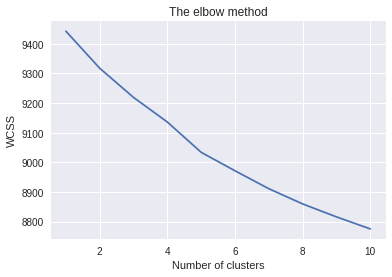

In [22]:
# Finding the optimum number of clusters for k-means classification
wcss = []

for i in range(1, 11):
  kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
  kmeans.fit(z)
  wcss.append(kmeans.inertia_)
  
# Plotting the results onto a line graph, allowing us to observe 'The elbow'
plt.plot(range(1, 11), wcss)
plt.title('The elbow method')
plt.xlabel("Number of clusters")
plt.ylabel('WCSS')
plt.show()

In [0]:
# Applying kmeans to the dataset / Creating the kmeans classifier
kmeans = KMeans(n_clusters = 3, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
y_kmeans = kmeans.fit(z)

In [24]:
# Number of points in each clusters 
pd.Series(kmeans.labels_).value_counts()

2    6709
1    2711
0     580
dtype: int64

In [25]:
y_kmeans.labels_

array([2, 0, 2, ..., 2, 1, 0], dtype=int32)

In [26]:
print(y_kmeans)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=-1, precompute_distances='auto',
    random_state=0, tol=0.0001, verbose=0)


In [0]:
y_km = y_kmeans.fit_predict(z)

In [28]:
print(y_kmeans.labels_[::10])

[2 2 2 2 1 2 2 2 0 1 1 1 2 2 2 1 2 1 1 2 2 2 0 2 1 2 2 1 2 0 2 1 2 2 2 1 1
 2 1 2 0 2 2 0 1 1 2 1 2 1 2 0 1 2 2 2 1 2 2 2 1 2 1 2 2 2 2 2 2 2 2 1 0 1
 2 2 2 1 0 2 1 2 1 2 2 2 1 2 2 2 2 2 1 2 2 0 1 1 2 2 0 2 1 2 2 2 2 2 0 2 2
 1 2 2 2 0 2 1 2 2 2 2 2 2 2 2 2 1 2 2 2 1 1 2 2 2 2 2 2 2 0 2 2 0 2 2 1 2
 2 2 0 1 2 1 2 2 2 2 2 2 2 2 2 2 2 0 2 0 1 2 1 2 2 1 2 1 2 1 1 2 2 2 2 1 2
 1 2 2 2 2 0 2 2 1 0 2 2 2 1 1 2 2 2 2 2 2 2 2 2 1 2 2 2 2 1 0 2 2 1 2 1 2
 2 2 2 2 1 2 2 2 2 1 1 2 1 2 2 2 1 0 2 1 1 2 1 2 2 2 1 2 2 0 1 2 2 2 2 2 1
 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 1 1 2 2 2 2 0 2 2 2 2 2 2 2 2 2 0 1
 2 1 2 1 2 1 2 1 2 1 2 1 2 2 2 1 2 2 1 2 1 1 2 2 2 2 0 0 2 2 2 2 2 2 2 1 2
 2 2 2 2 1 2 1 2 2 1 2 2 2 2 1 2 1 2 2 2 2 2 2 2 1 1 2 1 2 2 2 2 2 2 2 1 1
 2 1 2 2 1 2 2 2 1 1 1 0 1 2 2 2 2 1 2 2 2 2 0 0 2 2 2 2 2 1 1 2 1 2 2 1 2
 2 2 1 0 1 2 2 1 2 2 2 1 2 2 2 2 1 2 1 2 2 2 2 1 0 2 2 2 2 1 2 2 2 1 2 2 2
 0 2 2 1 2 2 2 2 1 1 1 2 2 2 2 2 1 2 1 2 0 2 2 2 1 2 2 2 2 2 2 2 1 2 2 2 2
 2 2 1 1 2 2 2 2 1 2 2 1 

In [29]:
pd.Series(y_kmeans.labels_).value_counts()

2    6709
1    2711
0     580
dtype: int64

In [0]:
def cluster_sample(clstr_label, sample_size=10):
    idx = y[kmeans.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [31]:
# Coffee
cluster_sample(0)


b'left breakroom ate one boy delici within minut bathroom continu day gastric distress max read wrapper gram fiber larg consum fiber diet say eat bar stop see happen due unexpect result give one star wonder bar grab breakroom wonder els offic suffer'
b'got health mana potion wow enthusiast think tast think tast better energi drink that matter opinion shock pull stock got instant cool mom happi great novelti though wouldnt pay exorbit price ship handl get'
b'glad found douw egbert aroma rood coffe first coffe addict coffe good aromat bitter delici coffe one far best ive found late spent year work manag own reataur good old day continent coff weshler one two like eveyth els bought replac standard product new kid block like starbuck even dunkin donut start vey good qualiti decreas sale increas bean look old dri upon open bag must tri varieti douw'
b'good coffe grew dutch like foam creat conveni speed coffe pod'
b'either review planter employe got bad batch type nut tast exact tast plastic

In [32]:
# Coffee flavor
cluster_sample(1)

b'husband make salsa tomato fire roast spec add alot flavor ive bought muir glen year never problem case can amazon tend arriv least dent though'
b'small can store expens larger can great save love'
b'cooki awesom kid total enjoy dunk milk packag perfect school lunch'
b'second coffe ive tri weaver first organ french roast prefer blend guess prefer darker roast hous blend coffe citrusi slight bitter tast bud french roast style coffe might excel option still good coffe ill probabl order french roast next time visibl found quaker weaver bag ive tri far quaker underdevelop coffe bean make coffe tast aw stick roast darken proper good test coffe bean empti bag cooki sheet see mani quaker find accept pretti bad opinion use pour method brew coffe everi day get water ideal brew temperatur use tablespoon coffe everi ounc cold filter water melitta natur brown filter manual drip coffe filter brew direct stainless caraf heat water boil pour tablespoon ground satur plump bean wait minut flood ground

### K-Medoids

In [0]:
import random

def kMedoids(D, k, tmax=100):
    # determine dimensions of distance matrix D
    m, n = D.shape

    if k > n:
        raise Exception('too many medoids')

    # find a set of valid initial cluster medoid indices since we
    # can't seed different clusters with two points at the same location
    valid_medoid_inds = set(range(n))
    invalid_medoid_inds = set([])
    rs,cs = np.where(D==0)
    # the rows, cols must be shuffled because we will keep the first duplicate below
    index_shuf = list(range(len(rs)))
    np.random.shuffle(index_shuf)
    rs = rs[index_shuf]
    cs = cs[index_shuf]
    for r,c in zip(rs,cs):
        # if there are two points with a distance of 0...
        # keep the first one for cluster init
        if r < c and r not in invalid_medoid_inds:
            invalid_medoid_inds.add(c)
    valid_medoid_inds = list(valid_medoid_inds - invalid_medoid_inds)

    if k > len(valid_medoid_inds):
        raise Exception('too many medoids (after removing {} duplicate points)'.format(
            len(invalid_medoid_inds)))

    # randomly initialize an array of k medoid indices
    M = np.array(valid_medoid_inds)
    np.random.shuffle(M)
    M = np.sort(M[:k])

    # create a copy of the array of medoid indices
    Mnew = np.copy(M)

    # initialize a dictionary to represent clusters
    C = {}
    for t in range(tmax):
        # determine clusters, i. e. arrays of data indices
        J = np.argmin(D[:,M], axis=1)
        for kappa in range(k):
            C[kappa] = np.where(J==kappa)[0]
        # update cluster medoids
        for kappa in range(k):
            J = np.mean(D[np.ix_(C[kappa],C[kappa])],axis=1)
            j = np.argmin(J)
            Mnew[kappa] = C[kappa][j]
        np.sort(Mnew)
        # check for convergence
        if np.array_equal(M, Mnew):
            break
        M = np.copy(Mnew)
    else:
        # final update of cluster memberships
        J = np.argmin(D[:,M], axis=1)
        for kappa in range(k):
            C[kappa] = np.where(J==kappa)[0]

    # return results
    return M, C

In [34]:
from sklearn.metrics.pairwise import pairwise_distances

D = pairwise_distances(z, metric='euclidean')

# split into 2 clusters
M, C = kMedoids(D, 2)

print('medoids:')
for i, point_idx in enumerate(M):
    if i > 5:
      break
    print(z[point_idx])

print('')
print('clustering result:')
for i, label in enumerate(C):
    if i > 5:
      break
    for point_idx in C[label]:
        print('label {0}:　{1}'.format(label, z[point_idx]))

medoids:
  (0, 74)	0.05076730825668096
  (0, 85)	0.02538365412834048
  (0, 222)	0.02538365412834048
  (0, 237)	0.07615096238502143
  (0, 240)	0.02538365412834048
  (0, 247)	0.02538365412834048
  (0, 250)	0.05076730825668096
  (0, 361)	0.02538365412834048
  (0, 462)	0.05076730825668096
  (0, 469)	0.02538365412834048
  (0, 539)	0.05076730825668096
  (0, 544)	0.07615096238502143
  (0, 546)	0.02538365412834048
  (0, 566)	0.02538365412834048
  (0, 578)	0.02538365412834048
  (0, 765)	0.02538365412834048
  (0, 769)	0.12691827064170239
  (0, 867)	0.10153461651336192
  (0, 891)	0.02538365412834048
  (0, 896)	0.02538365412834048
  (0, 943)	0.10153461651336192
  (0, 961)	0.02538365412834048
  (0, 992)	0.02538365412834048
  (0, 1035)	0.02538365412834048
  (0, 1049)	0.02538365412834048
  :	:
  (0, 8761)	0.02538365412834048
  (0, 8812)	0.17768557889838335
  (0, 8899)	0.05076730825668096
  (0, 8901)	0.02538365412834048
  (0, 9013)	0.02538365412834048
  (0, 9074)	0.02538365412834048
  (0, 9100)	0.1269

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



label 0:　  (0, 113)	0.1643989873053573
  (0, 1006)	0.3287979746107146
  (0, 1226)	0.1643989873053573
  (0, 2080)	0.1643989873053573
  (0, 2130)	0.1643989873053573
  (0, 2477)	0.3287979746107146
  (0, 2862)	0.1643989873053573
  (0, 3184)	0.1643989873053573
  (0, 3610)	0.1643989873053573
  (0, 3707)	0.4931969619160719
  (0, 3985)	0.1643989873053573
  (0, 4554)	0.1643989873053573
  (0, 4964)	0.1643989873053573
  (0, 6422)	0.1643989873053573
  (0, 7349)	0.1643989873053573
  (0, 7762)	0.1643989873053573
  (0, 7941)	0.1643989873053573
  (0, 8500)	0.1643989873053573
  (0, 8620)	0.1643989873053573
  (0, 9420)	0.1643989873053573
  (0, 9490)	0.1643989873053573
  (0, 9515)	0.1643989873053573
  (0, 9516)	0.1643989873053573
label 0:　  (0, 269)	0.2182178902359924
  (0, 979)	0.2182178902359924
  (0, 1290)	0.2182178902359924
  (0, 1305)	0.2182178902359924
  (0, 1487)	0.2182178902359924
  (0, 2679)	0.2182178902359924
  (0, 2862)	0.2182178902359924
  (0, 2899)	0.2182178902359924
  (0, 3114)	0.2182178902

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



label 1:　  (0, 9)	0.03298695623770211
  (0, 11)	0.03298695623770211
  (0, 20)	0.03298695623770211
  (0, 39)	0.06597391247540423
  (0, 40)	0.03298695623770211
  (0, 87)	0.03298695623770211
  (0, 88)	0.06597391247540423
  (0, 198)	0.03298695623770211
  (0, 237)	0.03298695623770211
  (0, 241)	0.03298695623770211
  (0, 251)	0.03298695623770211
  (0, 273)	0.03298695623770211
  (0, 333)	0.03298695623770211
  (0, 338)	0.03298695623770211
  (0, 342)	0.03298695623770211
  (0, 366)	0.06597391247540423
  (0, 376)	0.03298695623770211
  (0, 411)	0.03298695623770211
  (0, 463)	0.09896086871310633
  (0, 469)	0.03298695623770211
  (0, 473)	0.03298695623770211
  (0, 546)	0.03298695623770211
  (0, 548)	0.03298695623770211
  (0, 566)	0.09896086871310633
  (0, 693)	0.03298695623770211
  :	:
  (0, 8665)	0.06597391247540423
  (0, 8682)	0.03298695623770211
  (0, 8798)	0.03298695623770211
  (0, 8812)	0.06597391247540423
  (0, 8814)	0.03298695623770211
  (0, 9008)	0.03298695623770211
  (0, 9009)	0.032986956237

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




label 1:　  (0, 1417)	0.23570226039551587
  (0, 2183)	0.23570226039551587
  (0, 2768)	0.23570226039551587
  (0, 3490)	0.23570226039551587
  (0, 3493)	0.23570226039551587
  (0, 4101)	0.23570226039551587
  (0, 4408)	0.23570226039551587
  (0, 4544)	0.47140452079103173
  (0, 4597)	0.23570226039551587
  (0, 4608)	0.47140452079103173
  (0, 5023)	0.23570226039551587
  (0, 8451)	0.23570226039551587
label 1:　  (0, 74)	0.0936585811581694
  (0, 504)	0.0936585811581694
  (0, 566)	0.1873171623163388
  (0, 580)	0.2809757434745082
  (0, 664)	0.0936585811581694
  (0, 1088)	0.5619514869490164
  (0, 1146)	0.0936585811581694
  (0, 1193)	0.1873171623163388
  (0, 1311)	0.0936585811581694
  (0, 1939)	0.0936585811581694
  (0, 2009)	0.0936585811581694
  (0, 2067)	0.0936585811581694
  (0, 2340)	0.0936585811581694
  (0, 2431)	0.0936585811581694
  (0, 2493)	0.0936585811581694
  (0, 2588)	0.0936585811581694
  (0, 2709)	0.1873171623163388
  (0, 2862)	0.0936585811581694
  (0, 2868)	0.0936585811581694
  (0, 2875)	0.

## Hierarchical clustering

In [0]:
z = x[y, :].toarray()

In [36]:
from sklearn.pipeline import make_pipeline
from sklearn.cluster import AgglomerativeClustering
aglo = AgglomerativeClustering()
aglo.fit(z)


AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7f766066c8c8>)

In [0]:
def cluster_sample_aglo(clstr_label, sample_size=10):
    idx = y[aglo.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [38]:
# Tea
cluster_sample_aglo(0)

b'product first foray green tea like yogi tea green moder caus think drink grass moss yogi green tea decaffein drink larg quantiti give shake discov hot cup larg glass ice one day look substitut plain water cannot tell whether super formul anyth take expert word continu drink moder'
b'like coffe littl stronger one would never know decaf coffe fussi coffe drinker weak strong bitter undrink tulli coffe rule littl stronger brand overal typic hous blend dont mean whole lot one except bitter wateri wonder aroma decaf brand would ever recommend emeril brand weak husband drink decaf tri everi singl brand switch ground coffe one like doesnt like strong coffe dont like weak coffe love one final agre someth enjoy'
b'love dri endamam healthi snack also use salad lunch'
b'first ill respond whomev said brand doesnt come jar item descript mislead say bought sam look right husband told also saw smaller jar local harp yes product definit come jar second dont know anyon would say runni mayb brand maran

In [39]:
# Fruit
cluster_sample_aglo(1)

b'bought cliff kid twist fruit rope son care mother love take word kid label leav clif twist fruit rope conveni packag put one two purs need quick nutrit snack size pen slip right purs buy kid tast great'
b'awesom sauc done melt brain actual tast great tast sauc actual eat someth'
b'didnt realiz flavor thought first sip tast like chemic gave away next day work'
b'arriv fresh tast bit expens amount deliv worth gift found similar product local kroger store quit good much cheaper pound'
b'coffe dark rich yet bitter found room order communiti ever sinc amazon much cheaper hope keep avail like probabl pot brew'
b'put hot chocol experi youll never want miss share friend theyll addict'
b'appl butter great tast price would purchas know cost much produc small jar'
b'tri best cooki ever quaker never tast soft fresh cooki like quaker soft bake oatmeal cooki one lucki one receiv influenst mom voxbox complimentari test review purpos influenst voxbox come sever item one item quaker soft bake oatmeal

## TFIDF

In [0]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(min_df=10) 
tfidf_vectors = tfidf.fit_transform(df_sample['CleanedText'].values)

In [0]:
y = np.random.choice(tfidf_vectors.shape[0], size = 10000)

In [0]:
z = x[y, :]

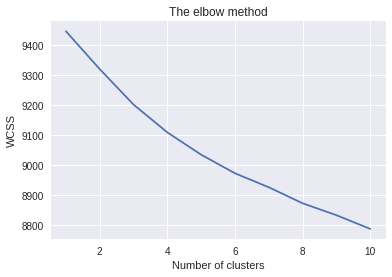

In [43]:
# Finding the optimum number of clusters for k-means classification
wcss = []

for i in range(1, 11):
  kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
  kmeans.fit(z)
  wcss.append(kmeans.inertia_)
  
# Plotting the results onto a line graph, allowing us to observe 'The elbow'
plt.plot(range(1, 11), wcss)
plt.title('The elbow method')
plt.xlabel("Number of clusters")
plt.ylabel('WCSS')
plt.show()

In [0]:
# Applying kmeans to the dataset / Creating the kmeans classifier
kmeans = KMeans(n_clusters = 3, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
y_kmeans = kmeans.fit(z)

In [45]:
# Number of points in each clusters 
pd.Series(y_kmeans.labels_).value_counts()

2    8514
1     851
0     635
dtype: int64

In [0]:
def cluster_sample(clstr_label, sample_size=10):
    idx = y[kmeans.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [47]:
# Fruits
cluster_sample(0)


b'recent receiv one bar voxbox review purpos realli quit enjoy banana person like almond figur would test glad wouldnt pick box groceri store sinc tri one purchas three box prefer microwav second sinc bar tast better heat also bit crunchi isnt overpow flavour size perfect carri around purs keep car travel bar also contain trace coconut pecan dont like either cant even tast ingredi'
b'ive sleep problem year noth realli work refus tri ambien prescript drug fear side effect use use tylenol found feel hangov effect morn recommend dream water pharmacist duan read job month ago ive use ever sinc relax help fall asleep night lay awak count sheep tast great unlik product ive tri prefer snoozeberri flavor lullabi lemon good final someth work'
b'would agre poor rate royal oak poor custom servic royal oak order year exact product last year arriv nut product would refund pay ship return also oper week peanut season otherwis email phone call even acknowledg'
b'tri mani juic world one best yet great

In [48]:
# Tea
cluster_sample(1)

b'youd think cant wrong basic stapl like rice right unfortun disappoint rice lotus food madagascar pink rice describ hint spice flavor cinnamon clove didnt pick slightest fact rice littl flavor normal buy brown basmati rice lotus food forbidden rice fantast rice enjoy without speck salt season ad madagascar pink cant begin compar wish avail small packag instead pound sack read full descript lotus food websit like idea rice amazon subscript price great deal went ill still eat rice cours serv recip dont depend rice flavor like whole grain rice provid'
b'one favorit tea digest probabl drink cup tea everi day'
b'product thin tasteless compar powder product know els say everyon know use need use least two sometim three littl contain make coffe tea look lighter noth creami product'
b'love tea refresh tast realli good hook dont think could get day without'
b'use cinnamon notic differ previous brand product good especi price'
b'order tea tri stop drink coffe love mango love peach thought would

### K-Medoids

In [49]:
from sklearn.metrics.pairwise import pairwise_distances

D = pairwise_distances(z, metric='euclidean')

# split into 2 clusters
M, C = kMedoids(D, 2)

print('medoids:')
for i, point_idx in enumerate(M):
    if i > 5:
      break
    print(z[point_idx] )

print('')
print('clustering result:')
for i, label in enumerate(C):
    if i > 5:
      break
    for point_idx in C[label]:
        print('label {0}:　{1}'.format(label, z[point_idx]))

medoids:
  (0, 74)	0.05076730825668096
  (0, 85)	0.02538365412834048
  (0, 222)	0.02538365412834048
  (0, 237)	0.07615096238502143
  (0, 240)	0.02538365412834048
  (0, 247)	0.02538365412834048
  (0, 250)	0.05076730825668096
  (0, 361)	0.02538365412834048
  (0, 462)	0.05076730825668096
  (0, 469)	0.02538365412834048
  (0, 539)	0.05076730825668096
  (0, 544)	0.07615096238502143
  (0, 546)	0.02538365412834048
  (0, 566)	0.02538365412834048
  (0, 578)	0.02538365412834048
  (0, 765)	0.02538365412834048
  (0, 769)	0.12691827064170239
  (0, 867)	0.10153461651336192
  (0, 891)	0.02538365412834048
  (0, 896)	0.02538365412834048
  (0, 943)	0.10153461651336192
  (0, 961)	0.02538365412834048
  (0, 992)	0.02538365412834048
  (0, 1035)	0.02538365412834048
  (0, 1049)	0.02538365412834048
  :	:
  (0, 8761)	0.02538365412834048
  (0, 8812)	0.17768557889838335
  (0, 8899)	0.05076730825668096
  (0, 8901)	0.02538365412834048
  (0, 9013)	0.02538365412834048
  (0, 9074)	0.02538365412834048
  (0, 9100)	0.1269

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




label 0:　  (0, 360)	0.105999788000636
  (0, 361)	0.105999788000636
  (0, 769)	0.105999788000636
  (0, 787)	0.105999788000636
  (0, 1061)	0.105999788000636
  (0, 1193)	0.105999788000636
  (0, 1413)	0.105999788000636
  (0, 1503)	0.31799936400190804
  (0, 1683)	0.211999576001272
  (0, 1800)	0.105999788000636
  (0, 2110)	0.105999788000636
  (0, 2137)	0.211999576001272
  (0, 2709)	0.105999788000636
  (0, 2862)	0.105999788000636
  (0, 2868)	0.105999788000636
  (0, 3005)	0.105999788000636
  (0, 3317)	0.211999576001272
  (0, 3610)	0.211999576001272
  (0, 4848)	0.211999576001272
  (0, 5023)	0.105999788000636
  (0, 5420)	0.105999788000636
  (0, 5576)	0.105999788000636
  (0, 5608)	0.105999788000636
  (0, 5623)	0.105999788000636
  (0, 5723)	0.105999788000636
  (0, 5754)	0.105999788000636
  (0, 5952)	0.105999788000636
  (0, 6398)	0.105999788000636
  (0, 6406)	0.105999788000636
  (0, 6717)	0.105999788000636
  (0, 6770)	0.105999788000636
  (0, 6875)	0.105999788000636
  (0, 6907)	0.105999788000636
  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




label 1:　  (0, 435)	0.2672612419124244
  (0, 1146)	0.2672612419124244
  (0, 1712)	0.2672612419124244
  (0, 3706)	0.2672612419124244
  (0, 4182)	0.2672612419124244
  (0, 4848)	0.2672612419124244
  (0, 4938)	0.2672612419124244
  (0, 5738)	0.2672612419124244
  (0, 6379)	0.5345224838248488
  (0, 6717)	0.2672612419124244
  (0, 7598)	0.2672612419124244
label 1:　  (0, 250)	0.19611613513818404
  (0, 849)	0.19611613513818404
  (0, 1656)	0.3922322702763681
  (0, 1951)	0.19611613513818404
  (0, 2564)	0.19611613513818404
  (0, 2868)	0.19611613513818404
  (0, 3361)	0.19611613513818404
  (0, 3502)	0.19611613513818404
  (0, 4030)	0.19611613513818404
  (0, 4729)	0.19611613513818404
  (0, 5052)	0.19611613513818404
  (0, 5432)	0.19611613513818404
  (0, 6200)	0.19611613513818404
  (0, 7012)	0.19611613513818404
  (0, 7230)	0.19611613513818404
  (0, 7341)	0.19611613513818404
  (0, 7349)	0.19611613513818404
  (0, 7931)	0.19611613513818404
  (0, 9100)	0.3922322702763681
  (0, 9528)	0.19611613513818404
label

## Hierarchical clustering

In [0]:
z = x[y, :].toarray()

In [51]:
aglo = AgglomerativeClustering()
aglo.fit(z)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7f766066c8c8>)

In [0]:
def cluster_sample_aglo(clstr_label, sample_size=10):
    idx = y[aglo.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [53]:
# Popcorn
cluster_sample_aglo(0)

b'hadnt chanc tri skippi natur honey sinc local store dont carri saw six pack deal amazon couldnt pass wont buy brand kind stuff delici'
b'good start suprem soy dha powder case pack six ounc can ounc reciev product within order price better ever paid past vendor thank much great servic'
b'move town could get stuff store saw could get case good price got tast much better plain oatmeal easi cook add littl water microwav minut yummi get subscript free ship better price'
b'cooki awesom kid total enjoy dunk milk packag perfect school lunch'
b'look heart palm ate brazilian restaur even last trip brazil search even though come peru exact palm tree brazilian heart palm product mushi tasteless yellowish conic shape like ecuador costa rica etc find groceri store discount club brazilian heart palm strong smell tast acid find woodi heart usual done natur woodi chunk saute use soup check emeril lagass recip pie add chicken pot pie littl bit cook make soft final brazilian type heart palm start chang

In [54]:
# Halvah
cluster_sample_aglo(1)

b'white chocol chip sinc dont contain cocoa butter that theyr label classic white instead white chocol dont tast good flavor noth near true white chocol flavor palm kernel oil whole milk powder nonfat dri milk palm oil soy lecithin vanilla good thing dont contain partial hydrogen oil fat like nestl white chip'
b'purchas wedg oro antico central market cost say impress look hard chees add chees mixtur bacon wrap jalapeno turn great choic usual use parmesan realli want tri someth new also use grate chees caesar salad sharp flavor went great dress oro antico bold chees great nose soft finish great pair red white wine look hard chees whatev reason give oro antico tri think pleasant surpris'
b'eat lunch everi day good health dont especi like water pack rather oliv oil even cost oil also help side believ get mani mouth becom dri harder swallow'
b'love crunch protein supplement lowest calori abl find tasti much like wafer cooki'
b'actual market better graham cracker made horribl ingredi certai

## Avg-W2V

In [55]:
from gensim.models import KeyedVectors
!wget -c "https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz"
w2v_model_google = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin.gz', binary=True)

--2018-08-11 03:43:36--  https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.32.83
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.32.83|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1647046227 (1.5G) [application/x-gzip]
Saving to: ‘GoogleNews-vectors-negative300.bin.gz’

GoogleNews-vectors- 100%[===================>]   1.53G  35.7MB/s    in 48s     

2018-08-11 03:44:24 (32.5 MB/s) - ‘GoogleNews-vectors-negative300.bin.gz’ saved [1647046227/1647046227]



In [56]:
avg_vec_google = [] #List to store all the avg w2vec's 
# no_datapoints = 364170
# sample_cols = random.sample(range(1, no_datapoints), 20001)
for sent in df_sample['CleanedText']:
    cnt = 0 #to count no of words in each reviews
    sent_vec = np.zeros(300) #Initializing with zeroes
#     print("sent:",sent) 
    sent = sent.decode("utf-8") 
    for word in sent.split():
        try:
#             print(word)
            wvec = w2v_model_google.wv[word] #Vector of each using w2v model
#             print("wvec:",wvec)
            sent_vec += wvec #Adding the vectors
#             print("sent_vec:",sent_vec)
            cnt += 1
        except: 
            pass #When the word is not in the dictionary then do nothing  
#     print(sent_vec)
    sent_vec /= cnt #Taking average of vectors sum of the particular review
#     print("avg_vec:",sent_vec)
    avg_vec_google.append(sent_vec) #Storing the avg w2vec's for each review
#     print("*******************************************************************")
# print(avg_vec_google)
avg_vec_google = np.array(avg_vec_google)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  if sys.path[0] == '':


In [57]:
np.isnan(avg_vec_google).any()

False

In [0]:
col_mean = np.nanmean(avg_vec_google, axis=0)

In [0]:
inds = np.where(np.isnan(avg_vec_google))

In [0]:
avg_vec_google[inds] = np.take(col_mean, inds[1])

In [61]:
np.any(np.isnan(avg_vec_google))

False

In [0]:
y = np.random.choice(avg_vec_google.shape[0], size = 10000)

In [0]:
z = avg_vec_google[y, :]

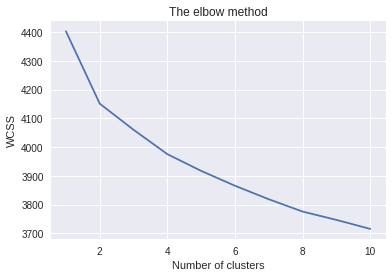

In [64]:
# Finding the optimum number of clusters for k-means classification
wcss = []

for i in range(1, 11):
  kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
  kmeans.fit(z)
  wcss.append(kmeans.inertia_)
  
# Plotting the results onto a line graph, allowing us to observe 'The elbow'
plt.plot(range(1, 11), wcss)
plt.title('The elbow method')
plt.xlabel("Number of clusters")
plt.ylabel('WCSS')
plt.show()

In [0]:
# Applying kmeans to the dataset / Creating the kmeans classifier
kmeans = KMeans(n_clusters = 2, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
y_kmeans = kmeans.fit(z)

In [66]:
# Number of points in each clusters 
pd.Series(y_kmeans.labels_).value_counts()

0    5724
1    4276
dtype: int64

In [0]:
def cluster_sample(clstr_label, sample_size=10):
    idx = y[aglo.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [68]:
# Coffee
cluster_sample(0)

b'thing quit easi hot go come reason delici addict bleep'
b'hope plenti vitamin drink found littl els like seal spout one adhes twist seal doesnt work well bottl matter fact tri open mine splatter product stain sad tast noth special tast like cannot recommend product'
b'bought french market dark coffe chicori two week ago subscrib save program go get can next due date caus love stuff want stock possib price increas well caus price increas increas subscrib save discount that stop buy ill cancel subscrib save order price doesnt drop back earth auto deliveri date great coffe ill drink tea pay much coffe new comment beyond notic french market dark coffe chicori drop way earlier today coffe excel best ive ever place addit subscrib save order great deal great coffe btw coffe use less half brand requir full flavor'
b'candi featur cochin extract bug blood addit recent embarrass major coffe vendor across america yes cochin bug yes cochin extract blood said insect add flavor use dye food red tre

In [69]:
# Coffee Masala
cluster_sample(1)

b'come rough cup much better deal purchas pack size gloria jean hazelnut regular retail pack worri anyth els lower qualiti perfect design differ pack size get one cardboard box either place holder rack leav box product like mild coffe like coffe light sweet add bit much cream milk tast coffe smell great though make cup fill room rich hazelnut aroma like bold bold bold bold extra bold coffe peopl'
b'baught candi son arriv bag candi stale son could even eat tri get contact compani refus get back sever attemp gave back product candi cheap keep buy basic threw money toilet would buy compani surf sweet candi wonder way better gummi worm ect yummi earth way bigger select'
b'prior start food miniatur pincher take benadryl sever breath problem vet attribut season allergi also start food doberman prone frequent eye infect would requir expens eye drop time per year littl research decid tri high qualiti food see would allevi min pin breath issu within day notic signific differ breath side result 

In [102]:
# Tea
cluster_sample(10)

b'live rural area limit access exot food bulk purchas hummus mix answer prayer end product excel cost half pay groceri store prepar hummus deli even includ ship cost isnt cheap like hummus adventur creat flavor great parti convers starter'
b'love quaker oatmeal squar healthier breakfast cereal option also make perfect snack'
b'great coffe flavor qualiti also lavazza coffe espresso machin recommend coffe'
b'love delici soft fresh packag packag bit wast realli keep check werent individu packag would probabl finish box within week see carnag packag usus shame slow lol similar sour candi sour enough one perfect balanc sour sweet yum five sour power candi calori gram carb gram sugar ouch noth nutrit sucker delici moder arent bad far junk goe eat alway drink water help rins sugar teeth brush teeth possibl box month individu packag take time eat expect anoth month probabl finish'
b'order brother love guess good product coffe expens day good deal'
b'great old fashion licoric hard candi drop bi

### K-Medoids

In [70]:
from sklearn.metrics.pairwise import pairwise_distances

D = pairwise_distances(z, metric='euclidean')

# split into 2 clusters
M, C = kMedoids(D, 2)

print('medoids:')
for i, point_idx in enumerate(M):
    if i > 5:
      break
    print(avg_vec_google[point_idx] )

print('')
print('clustering result:')
for i, label in enumerate(C):
    if i > 5:
      break
    for point_idx in C[label]:
        print('label {0}:　{1}'.format(label, avg_vec_google[point_idx]))

medoids:
[ 0.0101524   0.02865666  0.00266033  0.11115094 -0.02977552  0.05291916
  0.07910505 -0.1230676   0.07293705  0.19373554 -0.00839526 -0.14676596
  0.01487992 -0.01168373 -0.14441475  0.10556106 -0.04868317  0.14693532
 -0.04841273 -0.11274378  0.01513466  0.04388639  0.06516773 -0.07539671
 -0.05483308  0.01609867 -0.04905454  0.08607386 -0.04648601  0.04722373
 -0.01875814  0.0524557  -0.03991613 -0.01389586 -0.06364841 -0.00601764
  0.08272168 -0.03297202  0.05064741  0.1084914   0.09928862 -0.04937658
  0.11997477 -0.00378361 -0.02774069 -0.10900879 -0.04866271  0.01117961
 -0.06042892  0.00726416 -0.11605088  0.03823728 -0.08451397 -0.04333702
 -0.05112089  0.04839081 -0.049386   -0.02682154 -0.01577997 -0.1011451
 -0.06539968  0.07170765 -0.12782761 -0.04956109  0.00744975 -0.07005472
 -0.05392521 -0.09357782  0.06299257  0.08120565  0.08862949  0.00399001
  0.07714208  0.01556353 -0.11296996 -0.00264886  0.00973237  0.03663
  0.05707079  0.07818344  0.02743452 -0.095039

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



label 0:　[-5.22867839e-02  4.52813043e-02 -3.19908990e-02  1.55843099e-01
 -1.80884467e-02  5.16696506e-02 -7.69466824e-03 -5.46561347e-02
  1.10802121e-02  1.23348660e-01 -7.02921549e-03 -1.09056261e-01
 -2.76353624e-02 -8.03120931e-02 -9.49367947e-02  3.10262044e-02
  2.80287001e-02  6.87332153e-02 -1.11143324e-02  4.77430556e-03
 -2.66869068e-02 -1.92396376e-02  1.11823188e-01  8.81618924e-05
  6.10351562e-03 -4.35723199e-02 -7.02684191e-02  1.12969293e-01
  6.51041667e-03  3.42814128e-03 -7.96864827e-02  7.19875760e-02
  2.71131727e-02 -2.19730801e-02 -7.05295139e-03 -2.74183485e-02
  3.00665961e-02  7.05295139e-03  4.75302802e-02  4.94283040e-02
  8.46896701e-02 -3.73162164e-02  1.24172635e-01  2.32476128e-02
 -3.21324666e-02 -1.03892008e-01 -3.80350749e-02  6.37478299e-04
  5.39143880e-03  4.36876085e-02 -5.80783420e-02  1.03271484e-01
  6.39241536e-02  3.61531576e-02 -1.42720540e-02 -3.45865885e-02
 -7.30539958e-02 -6.38376872e-02  6.05129666e-02 -1.20802138e-01
 -8.79652235e-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




label 0:　[-6.07734007e-02 -5.98683077e-03  1.46129833e-02  2.25088680e-01
 -7.08364038e-03  2.97595753e-02  5.79506369e-02 -1.08087652e-01
  5.87283864e-03  1.43008064e-01 -1.72549977e-02 -1.13112506e-01
 -4.29929845e-02  4.62097280e-02 -1.26195571e-01  8.47522511e-02
 -1.62012437e-02  8.87787763e-02 -1.33990119e-02 -1.12369089e-01
  2.14139153e-02  7.24535690e-02  5.66717036e-02  4.04645134e-02
 -2.75914809e-03 -3.02124023e-03 -9.41853243e-02  3.88686236e-02
  1.04237725e-02 -9.84315311e-03 -7.01347800e-02  4.75912655e-02
  4.28933536e-02 -9.11578010e-03 -6.41048656e-03 -3.50826488e-02
  1.12688850e-01 -3.14779843e-02  5.41695987e-02  9.68197093e-02
  5.69157320e-02 -3.85024127e-02  1.12064137e-01  1.25678567e-02
 -6.37727625e-02 -1.44285314e-01 -1.17538452e-01 -1.18374544e-02
  6.57023262e-02  7.34075658e-02 -2.36434937e-02  4.46831198e-02
  3.00939223e-02  2.17285156e-02  4.79036219e-03 -2.67594281e-02
  2.52874038e-02 -6.20826272e-02 -7.79993394e-04 -1.00190555e-01
 -6.41084559e-0

IndexError: ignored

## Hierarchical clustering

In [0]:
z = x[y, :].toarray()

In [72]:
aglo = AgglomerativeClustering()
aglo.fit(z)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7f766066c8c8>)

In [0]:
def cluster_sample_aglo(clstr_label, sample_size=10):
    idx = y[aglo.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [74]:
# Tea
cluster_sample_aglo(0)

b'outsid fame silver needl white tea best white tea ive found sinc introduc white tea year ago uncl lee organ white tea next pick silver needl tea silver needl may best best also expens black green tea bite white tea smooth read high antioxid low caffin good hot ice'
b'box art alway make packag food look delici basic thin slice process beef top bed mash potato potato dens fluffi like photo substanti hearti textur sort solid block potato bottom bowl break apart fork ive upload photo show actual product look prepar easi poke hole top put microwav min textur beef potato expect process food gravi didnt tast right dish well expir date funni unpleas sour aftertast sodium content moder daili valu tast over salti buy particular varieti doesnt tast good'
b'purchas birthday gift relat took littl longer get would like otherwis would given star relat love browni'
b'box might think bar would standard size say larabar origin fruit nut bar bar varieti pack box kind plus cranberri almond antioxid nutr

In [75]:
# Snacks
cluster_sample_aglo(1)

b'excel snack parti snack great valu price servic excel pleas order pub mix'
b'ive tri find good chocol cover sunflow seed long young couldnt find easili chocol cover sunflow seed yanke trader tast realli good chocol realli good tast sunflow seed cowork said couldnt realli tell hanc star guess becasu use sunflow seed tast put littl next ill probabl eat whole bag day thank'
b'best tea hard find order case perfect littl bit ohoney awesom'
b'purchas daniel bresaola year ago first time skeptic item arriv well packag seal bag ice pack sinc order time qualiti product excel sometim amount salt ad differ general qualiti similar italian first tri bresaola itali know suppos tast like recommend slice profession knife thin make meat easier digest would fulli enjoy singl slice'
b'look realiz talk excess process food therefor one mayb lower expect go engag excess packag add unneccessari step suppos quick skillet meal go take task five differ packag insid pasta season packet hem broccoli floret chees

## DBSCAN Clustering

In [76]:
from sklearn.cluster import DBSCAN
db = DBSCAN(eps=2)
db.fit(z)

DBSCAN(algorithm='auto', eps=2, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=5, n_jobs=1, p=None)

In [0]:
def cluster_sample_db(clstr_label, sample_size=10):
    idx = y[db.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [78]:
# Tea
cluster_sample_db(0)

b'want cup tea deep rich satisfi flavor twine english breakfast decaf one want tri mani mani decaf tea disappoint flavor also find mani decaf nasti aftertast acid acid reflux twine decaf smooth final delici tea doesnt burn esophagus'
b'three cat one eat anyth anoth eat treat matter tri third runt litter eat treat other sure magic trick nice abl buy case sinc local pet shop stop carri'
b'normal buy loos leaf tea use infus tea bag tea doesnt cut youv real thing tea howev decent qualiti good flavor nice bodi without harsh compar stash tea store brand margin cheaper type tea much better dont want mess brew tea accept substitut make good ice tea well'
b'didnt high hope first open packet tea big herbal tea fan contain actual tea howev actual tea peppermint natur peppermint flavor first sip cant rememb got sampl amazon subscript case everi month also drink twine earl grey ladi grey regular prefer peppermint tea strong milk delici recommend follow steep time packet bonus organ'
b'almond dark c

In [79]:
# coffee
cluster_sample_db(1)

b'mother recommend tri royal jelli brand tri product general suppos work wonder arthriti pain ailment know peopl felt effect product havent say tast isnt bad look like regular honey satisfi sweet tooth dont see benefit product'
b'dog like much glad purchas share friend puppi puppi like think healthi dog recommend treat anyon dog'
b'eat high protein meal replac bar everi day breakfast lost sever pound bar high protein keep fuller longer lunchtim usual pretti hungri hold lunchtim without problem bit dri alway drink hand eat chocol flavor great cheap tast chocol usual come diet product bar nice chew isnt over chewi stick teeth good flavor best bar ever eaten far tast goe better toler sure bar lower fat content slim fast meal replac bar tri first place high fiber bar keep feel full sever hour replac meal day creat result follow diet plan two meal replac bar day three snack bar like increas weight loss pound lost eat one bar day'
b'product arriv time manner extrem well pack would buy vendor

## TF-IDF Word2vec

In [81]:
n_samples = 4000
df_sample_new = df_sample.sample(n_samples)
df_sample_new.sort_values('Time',inplace=True) 

from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(ngram_range=(1,2)) # Using bi-grams
tfidf_vec_new = tfidf.fit_transform(df_sample_new['CleanedText_NoStem'].values)
print(tfidf_vec_new.shape)
features = tfidf.get_feature_names()

(4000, 125926)


In [82]:
tfidf_w2v_vec_google = []
review = 0

for sent in df_sample_new['CleanedText_NoStem'].values:
    cnt = 0 
    weighted_sum  = 0
    sent_vec = np.zeros(300)
    sent = sent.decode("utf-8") 
    for word in sent.split():
        try:
            wvec = w2v_model_google.wv[word] 
            tfidf_vec = tfidf_vec_new[review,features.index(word)]
            sent_vec += (wvec * tfidf_vec)
            weighted_sum += tfidf_vec
        except:
            pass
    sent_vec /= weighted_sum
    tfidf_w2v_vec_google.append(sent_vec)
    review += 1
tfidf_w2v_vec_google = np.array(tfidf_w2v_vec_google)
saveindisk(tfidf_w2v_vec_google,"tfidf_w2v_vec_google")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  # This is added back by InteractiveShellApp.init_path()


In [0]:
y = np.random.choice(tfidf_w2v_vec_google.shape[0], size = 10000)
z = tfidf_w2v_vec_google[y, :]

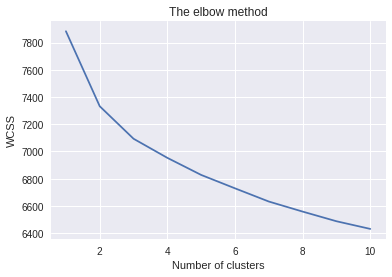

In [84]:
# Finding the optimum number of clusters for k-means classification
wcss = []

for i in range(1, 11):
  kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
  kmeans.fit(z)
  wcss.append(kmeans.inertia_)
  
# Plotting the results onto a line graph, allowing us to observe 'The elbow'
plt.plot(range(1, 11), wcss)
plt.title('The elbow method')
plt.xlabel("Number of clusters")
plt.ylabel('WCSS')
plt.show()

In [0]:
# Applying kmeans to the dataset / Creating the kmeans classifier
kmeans = KMeans(n_clusters = 2, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0, n_jobs = -1)
y_kmeans = kmeans.fit(z)

In [86]:
# Number of points in each clusters 
pd.Series(y_kmeans.labels_).value_counts()

1    6056
0    3944
dtype: int64

In [0]:
def cluster_sample(clstr_label, sample_size=10):
    idx = y[y_kmeans.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [99]:
# Dog food
cluster_sample(0)

b'flavor doh qualiti product use administ pill dog begin get hard find appar slow sale believ lack awar tell everyon sever tri realli like give tri'
b'tea delici toast rice give delic toasti flavor blend well soymilk amazon excel price product buy elsewher expens'
b'famili thought quaker oatmeal squar delici cereal light sweet crunchi nugget dont get soggi milk also delici snack right box calori bit high compar mani breakfast cereal per serv feel like cereal fill okay howev would wari replac normal bowl oatmeal cereal simpli thought sugar bit high'
b'like mustard sardin bit tangi mustard flavor simpli best ive ever found order two case hurrah scotland'
b'second beaba freezer tray weve purchas still use bought second tray make freez babi food time tray make serv portion easi run hot water back cup one two second frozen food pop right store individu serv ziplock sandwich bag make realli easi grab food day'
b'open product ship didnt work like review husband fix belt thing use pure food sm

In [100]:
# Tea
cluster_sample(1)

b'soup good low fat rememb cup two serv big fill coupl hundr calori ive tri mani mcdougal soup one take calori consider pretti darn good readi crack pepper your readi'
b'purchas macaroni style horribl chewi like calamari noth like macaroni dont like chewi textur tri konja brand shirataki angel hair pasta pretti good would reccomend brand thank good purchas packag'
b'celesti season kept tea consist level year ive use stay fresh take long time use box sinc sever differ box time qualiti hard come day keep good work'
b'like review ive tri chai brand yogi tazo etc one best sweeter tast other'
b'great sour sweet bought whenev bought costco mango berri mix sour mango alway got finish first also great salad'
b'health nut per vegetarian eat food healthili averag american perhap prefer organ ill nab chicken sandwich mcds pinch run lot fit buff might share experi get pretti crave veget put bodi physic stress think pretti good job tell need veggi realli satisfi crave susten feel put good nutrient 

### K-Medoids

In [90]:
from sklearn.metrics.pairwise import pairwise_distances

D = pairwise_distances(z, metric='euclidean')

# split into 2 clusters
M, C = kMedoids(D, 2)

print('medoids:')
for i, point_idx in enumerate(M):
    if i > 5:
      break
    print(tfidf_w2v_vec_google[point_idx] )

print('')
print('clustering result:')
for i, label in enumerate(C):
    if i > 5:
      break
    for point_idx in C[label]:
        print('label {0}:　{1}'.format(label, tfidf_w2v_vec_google[point_idx]))

medoids:
[-9.82402797e-02  3.18955534e-02 -2.54665853e-02  1.22504224e-01
 -3.62565843e-02  4.08346072e-02  7.16851589e-02 -1.09358863e-01
  1.23836944e-01  1.67480944e-01 -4.27607812e-02 -6.33121169e-02
  2.24611019e-02 -8.90875092e-02 -9.97065799e-02  7.93904612e-02
 -8.36475901e-02  5.12461832e-02 -7.78684071e-02 -5.87265771e-02
  3.57728183e-02  6.49581814e-02  3.86935017e-02  3.35025716e-02
  8.84081726e-03 -5.22623948e-02 -5.88498238e-02  1.37046296e-01
 -6.57716365e-03  2.70794830e-02 -7.14779617e-02  5.02211358e-02
 -5.29146136e-03 -1.55434257e-02  5.84222962e-03  9.41626939e-03
  7.79047765e-02 -3.05155015e-02  4.41552089e-02  9.70437205e-02
  5.95931012e-02 -7.29041846e-02  8.15966793e-02 -1.50190885e-02
  5.11179169e-03 -9.71180981e-02  1.21191027e-03  4.85307028e-02
  6.02896021e-02  7.90058836e-02 -4.81846148e-02  6.53400402e-03
 -1.74359338e-02 -9.00078039e-02 -1.58777684e-02 -4.17944889e-02
 -5.32054261e-02 -4.43954400e-02 -3.92969260e-02 -8.06465607e-02
 -7.46191247e-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



label 0:　[-2.60027583e-02 -3.35331831e-02 -3.56444693e-02  1.89296121e-01
 -5.44074053e-03  1.23112269e-03  6.53485365e-02 -4.55132614e-02
  2.16553684e-01  9.62167318e-02  4.24641404e-02 -8.75895729e-02
 -2.02773295e-02 -4.83515177e-03 -1.23032753e-01  1.79324256e-01
  2.53427485e-02  3.24346870e-02 -5.23042131e-02  6.99105700e-02
 -1.94948227e-02  3.46614388e-02  3.06072692e-02  6.20175150e-02
 -1.65697885e-02  6.65631016e-02 -1.61839675e-02  1.00785177e-01
 -4.35913898e-02 -5.36488016e-02 -6.29601559e-02  2.08480281e-02
 -6.71326511e-02 -3.97994402e-02  5.17859814e-02 -4.46808502e-02
  6.24887284e-02  2.59291505e-02  4.68994032e-04  7.03178598e-02
  6.02769757e-02 -6.02120022e-03  8.29292144e-02 -1.50884330e-01
 -1.30001557e-01 -1.32473687e-01  4.19611904e-03  1.32409392e-01
 -7.22540002e-02 -2.20724271e-02  4.28825055e-02 -4.56634554e-02
 -1.97748281e-02 -1.07382271e-01  2.56718365e-02 -7.79410203e-03
 -6.61324806e-02 -1.12168145e-01  6.11523873e-02 -1.36489285e-02
  7.10011661e-04

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



label 0:　[-2.38021563e-02 -1.21295904e-02  5.10338988e-02  1.12428167e-01
 -1.74091311e-02  7.03556969e-03  1.08423364e-01 -7.28835181e-02
 -3.80404307e-02  9.25613904e-02 -3.02364643e-02 -1.04679020e-01
 -1.73226491e-02  5.87372963e-02 -1.52924838e-01  1.62697415e-01
 -4.25291527e-02  1.61076829e-01  5.13954956e-02 -4.17176289e-02
 -1.00163830e-01  8.13849007e-02  8.72457626e-02 -2.42759473e-02
  2.70084290e-02 -6.14717939e-02 -1.23417836e-01  1.30635617e-01
 -6.42677075e-02 -7.00839353e-03 -8.85492914e-02  2.28441510e-03
  6.39968188e-03  5.57395945e-04 -6.13575676e-02  3.07121788e-02
  1.15049115e-01  4.50476897e-02  3.28579245e-02  8.07483709e-02
  5.64904603e-02 -1.17929953e-01  5.31958635e-02 -1.87743093e-02
  6.69191046e-02 -1.70634232e-01 -5.83474427e-02  3.92111941e-02
  6.50015315e-03 -1.59753163e-02 -9.62612616e-02 -1.33232053e-04
  2.17987492e-02 -6.57421787e-02  4.04215240e-02  3.43464222e-02
  1.97656180e-02 -1.03559554e-01 -1.25641471e-02 -1.95815459e-01
 -5.41667748e-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



label 0:　[ 0.00072637  0.01709627 -0.0909249   0.16467084  0.02767732  0.02830294
  0.05448288 -0.1476273  -0.0299743   0.27553966 -0.01765633 -0.09786843
 -0.08536337  0.0905483  -0.23467792  0.14291302 -0.06767928  0.06066714
 -0.03925537  0.01193455 -0.07049246  0.10643633  0.11633955  0.0224435
 -0.02459324 -0.03717008 -0.14453177  0.13112923 -0.05857553  0.00517797
  0.00512866  0.04181814  0.04595361 -0.00136705 -0.04499249 -0.01507988
  0.14799334 -0.08919139  0.0161263   0.03122028  0.19915703 -0.02682477
  0.11538322 -0.01067426  0.02666094 -0.16944725 -0.2201982  -0.0170366
 -0.0246773  -0.02987292 -0.1688489   0.18824504 -0.00959103  0.01263265
 -0.08832629  0.04683086 -0.00916732  0.03067111 -0.07346122 -0.18852051
 -0.17559655  0.06500183 -0.08955785 -0.08381317 -0.01494594 -0.12038008
 -0.09007149 -0.26182018  0.17336964 -0.00213548  0.0982439   0.05661657
 -0.00425565  0.0181266  -0.18327827 -0.04918765 -0.06449868 -0.06701206
 -0.03139652  0.02769808 -0.0360855   0.0173

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## Hierarchical clustering

In [0]:
z = x[y, :].toarray()

In [92]:
aglo = AgglomerativeClustering()
aglo.fit(z)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7f766066c8c8>)

In [0]:
def cluster_sample_aglo(clstr_label, sample_size=10):
    idx = y[aglo.labels_ == clstr_label]
    #print(idx)
    labeled_text = df_sample['CleanedText']
    sample_size = min(sample_size, len(labeled_text))
    for review in labeled_text.sample(sample_size):
        print(review[:1000])
        print('='*60)

In [94]:
# Coffee
cluster_sample_aglo(0)

b'coffe come filter without bottom assum save money reduc plastic work fine brewer ive tri coffe realli good bold tast bitter tast much better cream sugar end subscrib like much definit worth tri coffe drinker give item star far exceed expect get star'
b'wife introduc hickori smoke salt year ago seattl washington pike place market flavor aroma enhanc almost anyth burger fish caution use spare otherwis overwhelm flavor food end think youv dump dinner campfir took long first bottl search everi store imagin could find suppli longer make without thanx amazon carri uniqu item make life littl enjoy'
b'bought tea could find cranberri appl flavor bigelow drink offic like like pomegran even better sometim put smidg creme cassi realli fab combin'
b'alway long real crunch think thin bar bar came along sensat lack bar combin darker chocol nut everi bite tasti crunch satisfi one chew crave bought product bar trader joe saw amazon sold box jump price point havent ship problem review mention mine shi

In [95]:
# popchip
cluster_sample_aglo(1)

b'pretti nice brush clean automat cat water bowl brought versatil set brush reach almost crack crevic realli like lot'
b'super fast ship amaz eaten blue plate mayo long rememb happi still enjoy great tast even virginia thank amazon allow abl purchas thank blue plate compani make avail amazon continu mayo choic'
b'love hot sauc garlic flavor hard time find delici hot great flavor'
b'usual marin chicken italian dress use inject marinad ill never use lame italian dress chicken moist delici right amount spice tasti would absolut recommend product plan use thank toni chacher make chicken better'
b'provid nice assort popchip found avail store previous purchas small pack target contain bbq regular delight find price seem fair compar store sell'
b'avail holiday time make sens cannot sell candi made time'
b'happi plant reloc nyc abl bring plant miss one lone even new apart amazon com order plant expect much arriv shock big full lush plant arriv shes grow nice window thank'
b'abl quick easili pi

# Conclusion
* The optimum number of clusters for k-means classification for Bag of words and TF-IDF is 3 and for avgword2vec and tfidf word2vec is 2.
* Used * kmeans and hierarchial clustering * on all the vectorization technique.
* But * DBSCAN * used only on Word2Vector because it require high dimension.

# Reference
https://github.com/letiantian/kmedoids

https://www.mathworks.com

http://www.statisticshowto.com/wp-content/uploads/2016/11/clustergram.png

https://www.mathworks.com/matlabcentral/mlc-downloads/downloads/submissions/19344/versions/1/screenshot.jpg

https://cdn-images-1.medium.com/max/2000/1*zbm_3K647rvNDmgL6HWUNQ.png

https://image.slidesharecdn.com/kmeans-demo-150305202643-conversion-gate01/95/kmeans-with-canopy-clustering-24-638.jpg?cb=1425608917